# Setup

In [ ]:
# mount Google drive
from google.colab import drive
drive.mount('/content/drive')

# set the path 
%cd /content/drive/MyDrive/meal_recorder_ML

Mounted at /content/drive
/content/drive/MyDrive/meal_recorder_ML


In [ ]:
import tensorflow as tf
if tf.test.gpu_device_name():
    print('Default GPU Device: {}'.format(tf.test.gpu_device_name()))
else:
    print("Please install GPU version of TF")

Default GPU Device: /device:GPU:0


In [ ]:
!git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 100, done.
remote: Counting objects: 100% (100/100), done.
remote: Compressing objects: 100% (90/90), done.
remote: Total 53612 (delta 42), reused 68 (delta 10), pack-reused 53512
Receiving objects: 100% (53612/53612), 569.69 MiB | 23.26 MiB/s, done.
Resolving deltas: 100% (36793/36793), done.
Checking out files: 100% (2283/2283), done.


In [ ]:
%cd models/research/
!protoc object_detection/protos/*.proto --python_out=.
!cp object_detection/packages/tf2/setup.py .
!python -m pip install .

/content/drive/My Drive/meal_recorder_ML/models/research
Processing /content/drive/My Drive/meal_recorder_ML/models/research
     |████████████████████████████████| 9.0MB 14.6MB/s 
     |████████████████████████████████| 358kB 49.5MB/s 
     |████████████████████████████████| 1.1MB 57.3MB/s 
     |████████████████████████████████| 2.2MB 52.3MB/s 
     |████████████████████████████████| 17.7MB 216kB/s 
     |████████████████████████████████| 153kB 53.9MB/s 
     |████████████████████████████████| 61kB 9.4MB/s 
     |████████████████████████████████| 61kB 9.1MB/s 
     |████████████████████████████████| 829kB 47.0MB/s 
     |████████████████████████████████| 102kB 14.1MB/s 
     |████████████████████████████████| 51kB 8.1MB/s 
     |████████████████████████████████| 37.6MB 81kB/s 
     |████████████████████████████████| 706kB 51.7MB/s 
     |████████████████████████████████| 174kB 68.0MB/s 
     |████████████████████████████████| 1.2MB 58.1MB/s 
     |████████████████████████████████| 64

In [ ]:
%cd models/research/
!python object_detection/builders/model_builder_tf2_test.py

[Errno 2] No such file or directory: 'models/research/'
/content/drive/My Drive/meal_recorder_ML/models/research
2021-03-14 10:18:34.629839: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
Running tests under Python 3.7.10: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_model
2021-03-14 10:18:37.500242: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-14 10:18:37.501092: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-14 10:18:37.505831: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-14 10:18:37.506398: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 00

# Training

## Get pre-trained model

In [ ]:
!cp object_detection/model_main_tf2.py /content/drive/MyDrive/meal_recorder_ML

In [ ]:
%cd /content/drive/MyDrive/meal_recorder_ML/pre_trained_models/
!wget http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!tar -xvf ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
!rm ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz

/content/drive/MyDrive/meal_recorder_ML/pre_trained_models
--2021-02-26 22:14:54--  http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz
Resolving download.tensorflow.org (download.tensorflow.org)... 173.194.202.128, 2607:f8b0:400e:c07::80
Connecting to download.tensorflow.org (download.tensorflow.org)|173.194.202.128|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 46042990 (44M) [application/x-tar]
Saving to: ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’

ssd_mobilenet_v2_32 100%[===================>]  43.91M  81.8MB/s    in 0.5s    

2021-02-26 22:14:55 (81.8 MB/s) - ‘ssd_mobilenet_v2_320x320_coco17_tpu-8.tar.gz’ saved [46042990/46042990]

ssd_mobilenet_v2_320x320_coco17_tpu-8/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_320x320_coco17_tpu-8/c

In [ ]:
!cp ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config /content/drive/MyDrive/meal_recorder_ML/my_models/my_ssd_mobilenet_v2_320x320_coco17_tpu-8

## Training

In [ ]:
%cd /content/drive/MyDrive/meal_recorder_ML/
!python model_main_tf2.py --model_dir=my_models/my_256_ssd_mobilenet_v2_320x320_coco17_tpu-8 --pipeline_config_path=my_models/my_256_ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config --alsologtostderr

/content/drive/MyDrive/meal_recorder_ML
2021-02-27 12:23:51.883990: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-27 12:23:54.189829: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-27 12:23:54.190671: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-27 12:23:54.195307: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-27 12:23:54.195891: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-02-27 12:23:54.195926: I

## Evaluation

In [ ]:
%cd /content/drive/MyDrive/meal_recorder_ML/
!python model_main_tf2.py --model_dir=my_models/my_ssd_mobilenet_v2_320x320_coco17_tpu-8 --pipeline_config_path=my_models/my_ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config --checkpoint_dir=my_models/my_ssd_mobilenet_v2_320x320_coco17_tpu-8

/content/drive/MyDrive/meal_recorder_ML
2021-02-27 14:33:07.516047: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
W0227 14:33:15.921056 139860009801600 model_lib_v2.py:1043] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I0227 14:33:15.921386 139860009801600 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat16: False
I0227 14:33:15.921532 139860009801600 config_util.py:552] Maybe overwriting use_bfloat16: False
INFO:tensorflow:Maybe overwriting eval_num_epochs: 1
I0227 14:33:15.921664 139860009801600 config_util.py:552] Maybe overwriting eval_num_epochs: 1
W0227 14:33:15.921851 139860009801600 model_lib_v2.py:1058] Expected number of evaluation epochs is 1, but instead encountered `eval_on_train_input_config.num_epochs` = 0. Overwriting `num_epochs` to 1.
2021-02-27 14:33:

In [ ]:
%cd /content/drive/MyDrive/meal_recorder_ML/

/content/drive/MyDrive/meal_recorder_ML


In [ ]:
%load_ext tensorboard
%tensorboard --logdir 'my_models/my_ssd_mobilenet_v2_320x320_coco17_tpu-8'

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


<IPython.core.display.Javascript object>

# Export model

In [ ]:
with open('/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/tf_utils.py') as f:
    tf_utils = f.read()

with open('/usr/local/lib/python3.7/dist-packages/tensorflow/python/keras/utils/tf_utils.py', 'w') as f:
  # Set labelmap path
  throw_statement = "raise TypeError('Expected Operation, Variable, or Tensor, got ' + str(x))"
  tf_utils = tf_utils.replace(throw_statement, "if not isinstance(x, str):" + throw_statement)
  f.write(tf_utils)

In [ ]:
!cp /content/drive/MyDrive/meal_recorder_ML/models/research/object_detection/exporter_main_v2.py /content/drive/MyDrive/meal_recorder_ML

In [ ]:
%cd /content/drive/My Drive/meal_recorder_ML
!python exporter_main_v2.py --pipeline_config_path my_models/my_256_ssd_mobilenet_v2_320x320_coco17_tpu-8/pipeline.config --trained_checkpoint_dir my_models/my_256_ssd_mobilenet_v2_320x320_coco17_tpu-8 --output_directory my_models/exported_models/exported_my_256_ssd_mobilenet_v2_320x320_coco17_tpu-8

/content/drive/My Drive/meal_recorder_ML
2021-02-27 14:36:20.398393: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.10.1
2021-02-27 14:36:22.449463: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-02-27 14:36:22.450367: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-02-27 14:36:22.454666: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-02-27 14:36:22.455216: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-02-27 14:36:22.455242: 

## Convert model with tensorflowjs

In [ ]:
!pip install tensorflowjs
!pip install tf_slim

     |████████████████████████████████| 71kB 5.5MB/s 
     |████████████████████████████████| 112kB 11.0MB/s 
  Found existing installation: tensorflow-hub 0.11.0
    Uninstalling tensorflow-hub-0.11.0:
      Successfully uninstalled tensorflow-hub-0.11.0


In [ ]:
!tensorflowjs_converter \
--input_format=tf_saved_model \
--quantize_uint8 \
--saved_model_tags=serve \
--output_format=tfjs_graph_model \
my_models/exported_models/exported_my_ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model \
my_models/exported_models/exported_my_ssd_mobilenet_v2_320x320_coco17_tpu-8/lightweight_web_model

2021-03-14 10:39:34.156580: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcudart.so.11.0
2021-03-14 10:39:37.357717: I tensorflow/compiler/jit/xla_cpu_device.cc:41] Not creating XLA devices, tf_xla_enable_xla_devices not set
2021-03-14 10:39:37.358559: I tensorflow/stream_executor/platform/default/dso_loader.cc:49] Successfully opened dynamic library libcuda.so.1
2021-03-14 10:39:37.362778: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:941] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-03-14 10:39:37.363322: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1720] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla P100-PCIE-16GB computeCapability: 6.0
coreClock: 1.3285GHz coreCount: 56 deviceMemorySize: 15.90GiB deviceMemoryBandwidth: 681.88GiB/s
2021-03-14 10:39:37.363349: I tensorflow/stream_executor/platform/def

# Test model

In [ ]:
import io
import os
import scipy.misc
import numpy as np
import six
import time
import glob
from IPython.display import display

from six import BytesIO

import matplotlib
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw, ImageFont

import tensorflow as tf
from object_detection.utils import ops as utils_ops
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as vis_util

%matplotlib inline

In [ ]:
def load_image_into_numpy_array(path):
  """Load an image from file into a numpy array.

  Puts image into numpy array to feed into tensorflow graph.
  Note that by convention we put it into a numpy array with shape
  (height, width, channels), where channels=3 for RGB.

  Args:
    path: a file path (this can be local or on colossus)

  Returns:
    uint8 numpy array with shape (img_height, img_width, 3)
  """
  img_data = tf.io.gfile.GFile(path, 'rb').read()
  image = Image.open(BytesIO(img_data))
  (im_width, im_height) = image.size
  return np.array(image.getdata()).reshape(
      (im_height, im_width, 3)).astype(np.uint8)

In [ ]:
labelmap_path = '/content/drive/MyDrive/meal_recorder_ML/annotations/10_classes_label_map.pbtxt'
category_index = label_map_util.create_category_index_from_labelmap(labelmap_path, use_display_name=True)

In [ ]:
tf.keras.backend.clear_session()
model = tf.saved_model.load('/content/drive/MyDrive/meal_recorder_ML/my_models/exported_models/exported_my_ssd_mobilenet_v2_320x320_coco17_tpu-8/saved_model')

In [ ]:
def run_inference_for_single_image(model, image):
  image = np.asarray(image)
  # The input needs to be a tensor, convert it using `tf.convert_to_tensor`.
  input_tensor = tf.convert_to_tensor(image)
  # The model expects a batch of images, so add an axis with `tf.newaxis`.
  input_tensor = input_tensor[tf.newaxis,...]

  # Run inference
  model_fn = model.signatures['serving_default']
  output_dict = model_fn(input_tensor)

  # All outputs are batches tensors.
  # Convert to numpy arrays, and take index [0] to remove the batch dimension.
  # We're only interested in the first num_detections.
  num_detections = int(output_dict.pop('num_detections'))
  output_dict = {key:value[0, :num_detections].numpy() 
                 for key,value in output_dict.items()}
  output_dict['num_detections'] = num_detections

  # detection_classes should be ints.
  output_dict['detection_classes'] = output_dict['detection_classes'].astype(np.int64)
   
  # Handle models with masks:
  if 'detection_masks' in output_dict:
    # Reframe the the bbox mask to the image size.
    detection_masks_reframed = utils_ops.reframe_box_masks_to_image_masks(
              output_dict['detection_masks'], output_dict['detection_boxes'],
               image.shape[0], image.shape[1])      
    detection_masks_reframed = tf.cast(detection_masks_reframed > 0.4,
                                       tf.uint8)
    output_dict['detection_masks_reframed'] = detection_masks_reframed.numpy()
    
  return output_dict

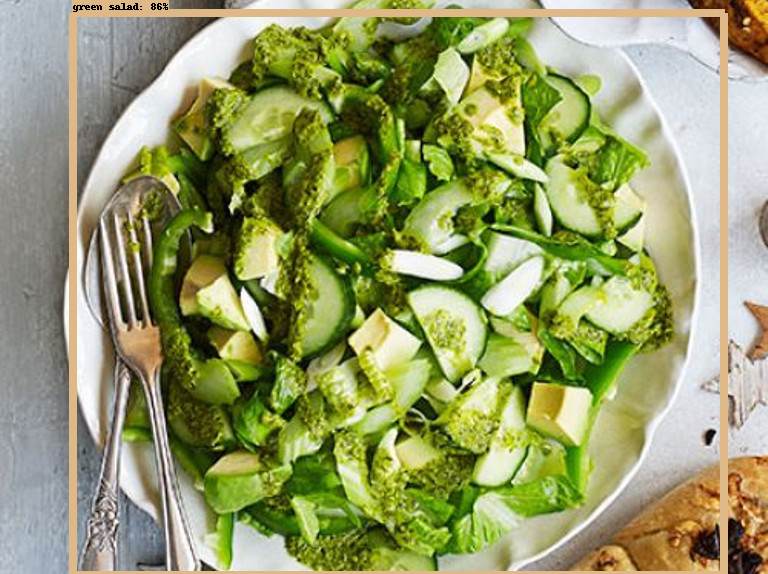

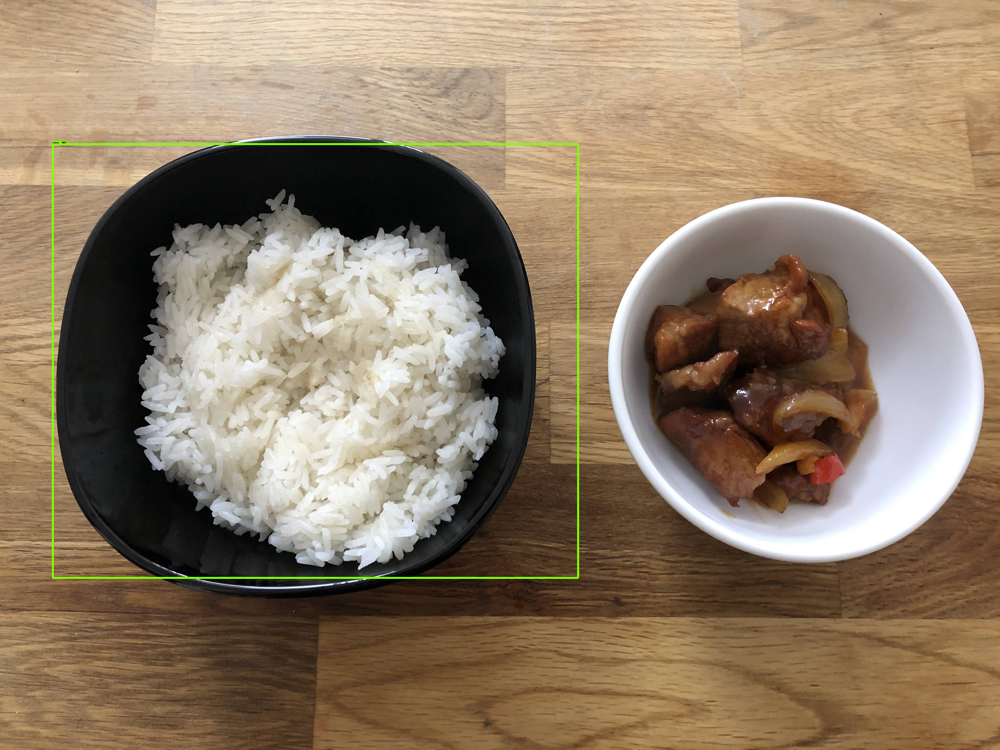

In [ ]:
for image_path in glob.glob('/content/drive/MyDrive/meal_recorder_ML/test_images/*.jpg'):
  image_np = load_image_into_numpy_array(image_path)
  output_dict = run_inference_for_single_image(model, image_np)
  print(output_dict)
  vis_util.visualize_boxes_and_labels_on_image_array(
      image_np,
      output_dict['detection_boxes'],
      output_dict['detection_classes'],
      output_dict['detection_scores'],
      category_index,
      instance_masks=output_dict.get('detection_masks_reframed', None),
      use_normalized_coordinates=True,
      line_thickness=8)
  display(Image.fromarray(image_np))